In [1]:
import numpy as np # linear algebra
import pandas as pd # data processing, CSV file I/O (e.g. pd.read_csv)
import matplotlib.pyplot as plt
from dataprep.eda import *
import seaborn as sns
import warnings
warnings.filterwarnings("ignore")
sns.set_theme(style = "darkgrid")

In [2]:
# read data
path = "data/train.csv"
data = pd.read_csv(path)

In [3]:
# display top 10 rows
data.head(10)

,Id,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,...,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
0,0,3189,40,8,30,13,3270,206,234,193,...,0,0,0,0,0,0,0,0,0,1
1,1,3026,182,5,280,29,3270,233,240,106,...,0,0,0,0,0,0,0,0,0,2
2,2,3106,13,7,351,37,2914,208,234,137,...,0,0,0,0,0,0,0,0,0,1
3,3,3022,276,13,192,16,3034,207,238,156,...,0,0,0,0,0,0,0,0,0,2
4,4,2906,186,13,266,22,2916,231,231,154,...,0,0,0,0,0,0,0,0,0,2
5,5,3115,144,2,415,61,3371,223,231,131,...,0,0,0,0,0,0,0,0,0,1
6,6,2930,61,5,312,32,3731,225,248,163,...,0,0,0,0,0,0,0,0,0,2
7,7,3208,94,4,187,63,7151,231,228,173,...,0,0,0,0,0,0,0,0,0,2
8,8,3182,67,12,126,22,3098,240,226,121,...,0,0,0,0,0,0,0,0,0,1
9,9,2892,46,16,231,73,4591,231,249,106,...,0,0,0,0,0,0,0,0,0,2


In [4]:
# number of rows and columns in dataset
rows = data.shape[0]
columns = data.shape[1]
print("Data has {} rows, {} columns".format(rows, columns))

Data has 4000000 rows, 56 columns


In [5]:
data.drop(['Id'], axis = 1, inplace = True)

In [46]:
from sklearn.model_selection import train_test_split

# set of independent variables
X = data.drop(['Cover_Type'], axis = 1)
# dependent variable
y = data['Cover_Type']

X_train, X_val, y_train, y_val = train_test_split(X, y, test_size = 0.3, random_state=5)

# ****EDA****

In [47]:
pd.set_option('display.max_columns', 100)
# display descriptive stats
data.describe()

,Elevation,Aspect,Slope,Horizontal_Distance_To_Hydrology,Vertical_Distance_To_Hydrology,Horizontal_Distance_To_Roadways,Hillshade_9am,Hillshade_Noon,Hillshade_3pm,Horizontal_Distance_To_Fire_Points,Wilderness_Area1,Wilderness_Area2,Wilderness_Area3,Wilderness_Area4,Soil_Type1,Soil_Type2,Soil_Type3,Soil_Type4,Soil_Type5,Soil_Type6,Soil_Type7,Soil_Type8,Soil_Type9,Soil_Type10,Soil_Type11,Soil_Type12,Soil_Type13,Soil_Type14,Soil_Type15,Soil_Type16,Soil_Type17,Soil_Type18,Soil_Type19,Soil_Type20,Soil_Type21,Soil_Type22,Soil_Type23,Soil_Type24,Soil_Type25,Soil_Type26,Soil_Type27,Soil_Type28,Soil_Type29,Soil_Type30,Soil_Type31,Soil_Type32,Soil_Type33,Soil_Type34,Soil_Type35,Soil_Type36,Soil_Type37,Soil_Type38,Soil_Type39,Soil_Type40,Cover_Type
count,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4000000.0,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4000000.0,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06,4.000000e+06
mean,2.980192e+03,1.515857e+02,1.509754e+01,2.713154e+02,5.166262e+01,1.766642e+03,2.118375e+02,2.210614e+02,1.408109e+02,1.581407e+03,2.611930e-01,4.166100e-02,6.535732e-01,2.181900e-02,1.684150e-02,3.089600e-02,4.275500e-03,3.791275e-02,1.571525e-02,7.972750e-03,0.0,2.899750e-03,1.089300e-02,5.454075e-02,2.798525e-02,1.829000e-02,3.129525e-02,1.497650e-02,0.0,1.588850e-02,2.067175e-02,1.343625e-02,1.381125e-02,1.736800e-02,1.153900e-02,3.134600e-02,4.917075e-02,2.502175e-02,3.258250e-03,1.352700e-02,1.176575e-02,1.070775e-02,2.227350e-02,2.886700e-02,2.749325e-02,3.746200e-02,3.782075e-02,1.199500e-02,1.605350e-02,1.071275e-02,1.220750e-02,4.075150e-02,3.923925e-02,3.161850e-02,1.771335e+00
std,2.890482e+02,1.099611e+02,8.546731e+00,2.265497e+02,6.821597e+01,1.315610e+03,3.075996e+01,2.223134e+01,4.369864e+01,1.127616e+03,4.392849e-01,1.998133e-01,4.758312e-01,1.460922e-01,1.286774e-01,1.730360e-01,6.524738e-02,1.909853e-01,1.243716e-01,8.893361e-02,0.0,5.377120e-02,1.037995e-01,2.270816e-01,1.649305e-01,1.339981e-01,1.741145e-01,1.214587e-01,0.0,1.250442e-01,1.422829e-01,1.151335e-01,1.167069e-01,1.306383e-01,1.067982e-01,1.742511e-01,2.162244e-01,1.561911e-01,5.698802e-02,1.155163e-01,1.078301e-01,1.029228e-01,1.475717e-01,1.674327e-01,1.635157e-01,1.898910e-01,1.907625e-01,1.088629e-01,1.256813e-01,1.029465e-01,1.098111e-01,1.977140e-01,1.941637e-01,1.749822e-01,8.938060e-01
min,1.773000e+03,-3.300000e+01,-3.000000e+00,-9.200000e+01,-3.170000e+02,-2.870000e+02,-4.000000e+00,4.900000e+01,-5.300000e+01,-2.770000e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,1.000000e+00
25%,2.760000e+03,6.000000e+01,9.000000e+00,1.100000e+02,4.000000e+00,8.220000e+02,1.980000e+02,2.100000e+02,1.150000e+02,7.810000e+02,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.0,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+00,0.000000e+

## UNIVARIATE ANALYSIS

**ELEVATION**

Distribution : About Normal

Outlier : Yes

Null : No

Incorrect Values : No

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


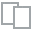
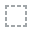
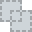
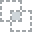
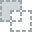
...
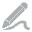
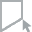
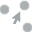
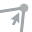
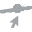

In [48]:
plot(X_train, col1 = 'Elevation')

**ASPECT**

Distribution : About Skewed

Outlier : No

Null : No

Incorrect Values : Yes

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


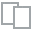
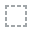
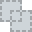
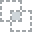
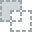
...
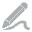
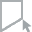
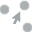
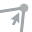
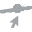

In [49]:
plot(X_train, col1 = 'Aspect')

Since Aspect is measured in Degree Azimuth, and it ranges from 0 to 360. Thus considering all values less than 0 as 360+x and all values greater than 360 as x-360.

In [50]:
# select all rows with incorrect values
incorrect_aspect_train = ((X_train['Aspect']<0) | (X_train['Aspect']>360))
incorrect_aspect_val = ((X_val['Aspect']<0) | (X_val['Aspect']>360))

# correct values
X_train.loc[incorrect_aspect_train, 'Aspect'] = X_train[incorrect_aspect_train]['Aspect']%360
X_val.loc[incorrect_aspect_val, 'Aspect'] = X_val[incorrect_aspect_val]['Aspect']%360

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


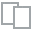
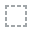
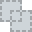
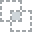
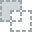
...
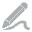
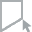
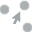
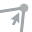
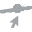

In [51]:
plot(X_train, col1 = "Aspect")

**SLOPE**

Distribution : Positively Skewed

Outlier : Yes

Null : No

Incorrect Values : No (Assuming negative values denote a down slope)

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


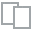
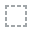
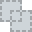
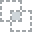
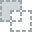
...
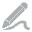
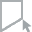
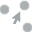
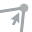
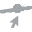

In [52]:
plot(X_train, col1 = 'Slope')

**Horizontal_Distance_To_Hydrology**

Distribution : Positively Skewed

Outlier : Yes

Null : No

Incorrect Values : Yes

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


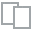
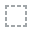
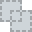
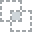
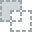
...
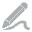
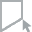
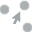
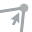
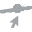

In [53]:
plot(X_train, col1 = 'Horizontal_Distance_To_Hydrology')

Since distance as a scalar can't be negative or positive thus taking modulus of negative values

In [54]:
# correct negative values
X_train['Horizontal_Distance_To_Hydrology'] = abs(X_train['Horizontal_Distance_To_Hydrology'])
X_val['Horizontal_Distance_To_Hydrology'] = abs(X_val['Horizontal_Distance_To_Hydrology'])

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


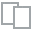
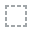
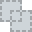
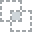
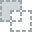
...
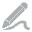
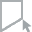
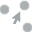
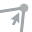
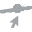

In [55]:
plot(X_train, col1 = 'Horizontal_Distance_To_Hydrology')

**Vertical_Distance_To_Hydrology**

Distribution : Positively Skewed

Outlier : Yes

Null : No

Incorrect Values : Yes

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


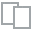
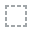
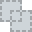
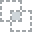
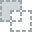
...
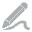
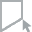
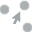
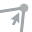
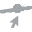

In [56]:
plot(X_train, col1 = 'Vertical_Distance_To_Hydrology')

Correcting negative values

In [57]:
# correct negative values
X_train['Vertical_Distance_To_Hydrology'] = abs(X_train['Vertical_Distance_To_Hydrology'])
X_val['Vertical_Distance_To_Hydrology'] = abs(X_val['Vertical_Distance_To_Hydrology'])

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


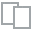
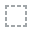
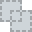
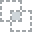
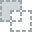
...
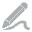
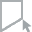
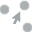
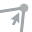
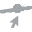

In [58]:
plot(X_train, col1 = 'Vertical_Distance_To_Hydrology')

**Horizontal_Distance_To_Roadways**

Distribution : Positively Skewed

Outlier : Yes

Null : No

Incorrect Values : Yes

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


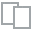
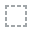
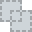
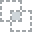
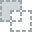
...
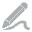
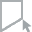
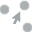
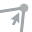
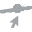

In [59]:
plot(X_train, col1 = 'Horizontal_Distance_To_Roadways')

In [60]:
# correct negative values
X_train['Horizontal_Distance_To_Roadways'] = abs(X_train['Horizontal_Distance_To_Roadways'])
X_val['Horizontal_Distance_To_Roadways'] = abs(X_val['Horizontal_Distance_To_Roadways'])

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


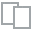
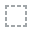
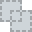
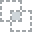
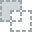
...
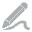
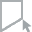
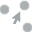
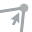
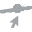

In [61]:
plot(X_train, col1 = 'Horizontal_Distance_To_Roadways')

**Hillshade_9am**

Distribution : Negatively Skewed

Outlier : Yes

Null : No

Incorrect Values : Yes

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


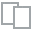
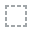
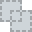
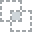
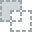
...
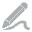
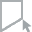
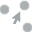
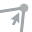
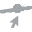

In [62]:
plot(X_train, col1 = 'Hillshade_9am')

Since the values in Hillshade columns have to be from 0 to 255 thus correcting wherever necessary

In [63]:
# correct negative values
X_train['Hillshade_9am'] = abs(X_train['Hillshade_9am'])
X_val['Hillshade_9am'] = abs(X_val['Hillshade_9am'])

In [64]:
# selecting incorrect values
incorrect_hillshade_9am_train = (X_train['Hillshade_9am']>255)
incorrect_hillshade_9am_val = (X_val['Hillshade_9am']>255)

# correcting values
X_train.loc[incorrect_hillshade_9am_train, 'Hillshade_9am'] = X_train[incorrect_hillshade_9am_train]['Hillshade_9am']%255
X_val.loc[incorrect_hillshade_9am_val, 'Hillshade_9am'] = X_val[incorrect_hillshade_9am_val]['Hillshade_9am']%255

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


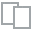
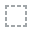
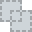
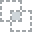
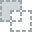
...
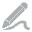
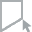
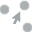
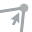
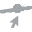

In [65]:
plot(X_train, col1 = 'Hillshade_9am')

**Hillshade_Noon**

Distribution : Negatively Skewed

Outlier : Yes

Null : No

Incorrect Values : Yes

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


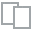
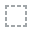
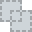
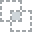
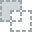
...
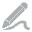
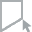
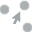
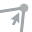
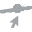

In [66]:
plot(X_train, col1 = 'Hillshade_Noon')

In [67]:
# correct negative values
X_train['Hillshade_Noon'] = abs(X_train['Hillshade_Noon'])
X_val['Hillshade_Noon'] = abs(X_val['Hillshade_Noon'])

In [68]:
# selecting incorrect values
incorrect_hillshade_noon_train = (X_train['Hillshade_Noon']>255)
incorrect_hillshade_noon_val = (X_val['Hillshade_Noon']>255)

# correcting values
X_train.loc[incorrect_hillshade_noon_train, 'Hillshade_Noon'] = X_train[incorrect_hillshade_noon_train]['Hillshade_Noon']%255
X_val.loc[incorrect_hillshade_noon_val, 'Hillshade_Noon'] = X_val[incorrect_hillshade_noon_val]['Hillshade_Noon']%255


 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


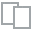
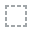
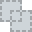
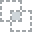
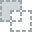
...
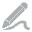
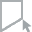
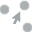
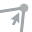
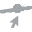

In [69]:
plot(X_train, col1='Hillshade_Noon')

**Hillshade_3pm**

Distribution : About Normal

Outlier : Yes

Null : No

Incorrect Values : Yes

 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


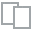
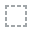
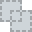
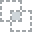
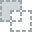
...
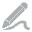
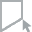
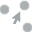
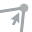
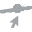

In [70]:
plot(X_train, col1 = 'Hillshade_3pm')

In [71]:
# correct negative values
X_train['Hillshade_3pm'] = abs(X_train['Hillshade_3pm'])
X_val['Hillshade_3pm'] = abs(X_val['Hillshade_3pm'])

In [72]:
# selecting incorrect values
incorrect_hillshade_3pm_train = (X_train['Hillshade_3pm']>255)
incorrect_hillshade_3pm_val = (X_val['Hillshade_3pm']>255)

# correcting values
X_train.loc[incorrect_hillshade_3pm_train, 'Hillshade_3pm'] = X_train[incorrect_hillshade_3pm_train]['Hillshade_3pm']%255
X_val.loc[incorrect_hillshade_3pm_val, 'Hillshade_3pm'] = X_val[incorrect_hillshade_3pm_val]['Hillshade_3pm']%255


 67%|######6   | 2/3 [00:00<?, ?it/s]

  0%|          | 0/126 [00:00<?, ?it/s]


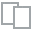
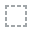
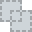
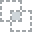
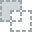
...
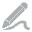
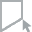
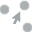
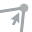
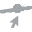

In [73]:
plot(X_train, col1='Hillshade_3pm')